In [1]:
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torch.utils.data import DataLoader
from torchvision import datasets, transforms
from torchvision.utils import make_grid
import matplotlib.pyplot as plt
import numpy as np

torch.manual_seed(42)
np.random.seed(42)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [2]:
IMAGE_SIZE = 32 #change this to make it 64 x 64
num_channels = 3
num_classes = 10
noise_dimension = 100
label_embedding_size = 256
batch_size = 128
num_epochs = 150
learning_rate = 0.00015
beta1 = 0.5
critic_iterations = 5
weight_clip_value = 0.01
class_names = ['airplane', 'automobile', 'bird', 'cat', 'deer', 'dog', 'frog', 'horse', 'ship', 'truck']

In [3]:
if IMAGE_SIZE == 64:
    data_transform = transforms.Compose([
        transforms.Resize(IMAGE_SIZE),
        transforms.ToTensor(),
        transforms.Normalize([0.5, 0.5, 0.5], [0.5, 0.5, 0.5])
    ])
else:
    data_transform = transforms.Compose([
        transforms.ToTensor(),
        transforms.Normalize([0.5, 0.5, 0.5], [0.5, 0.5, 0.5])
    ])

cifar10_dataset = datasets.CIFAR10(
    root='./data', 
    train=True, 
    download=False,
    transform=data_transform
)

data_loader = DataLoader(
    cifar10_dataset, 
    batch_size=batch_size, 
    shuffle=True, 
    num_workers=1, 
    drop_last=True
)

print(f'size=  {len(cifar10_dataset)}')
print(f'num baches = {len(data_loader)}')
sample_batch = next(iter(data_loader))
sample_images = sample_batch[0][:16]
sample_grid = make_grid(sample_images, nrow=4, normalize=True)

size=  50000
num baches = 390


In [4]:
def initialize_weights(model):
    classname = model.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(model.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(model.weight.data, 1.0, 0.02)
        nn.init.constant_(model.bias.data, 0)

def display_images(images, title='', num_images_per_row=8):
    images_denormalized = images * 0.5 + 0.5
    image_grid = make_grid(images_denormalized.cpu()[:64], nrow=num_images_per_row, padding=2)
    
    plt.figure(figsize=(10, 10))
    plt.imshow(image_grid.permute(1, 2, 0).numpy())
    plt.title(title)
    plt.axis('off')
    plt.show()

def plot_training_losses(generator_losses, discriminator_losses, model_name='Model'):
    plt.figure(figsize=(10, 5))
    plt.plot(generator_losses, label='generator loss')
    plt.plot(discriminator_losses, label='discriminator loss')
    plt.xlabel('iterations')
    plt.ylabel('loss')
    plt.title(f'{model_name} training losses')
    plt.legend()
    plt.grid(True)
    plt.show()

In [5]:
class Generator(nn.Module):
    def __init__(self, noise_dim=100, num_classes=10, embedding_size=256, image_size=64):
        super(Generator, self).__init__()
        self.image_size = image_size
        self.label_embedding_layer = nn.Embedding(num_classes, embedding_size)
        combined_input_size = noise_dim + embedding_size
        self.initial_dense_layer = nn.Linear(combined_input_size, 4 * 4 * 512)
        
        if image_size == 32:
            self.upsampling_layers = nn.Sequential(
                # Start: 4×4×512
                nn.BatchNorm2d(512, momentum=0.1),
                nn.ReLU(True),
                nn.ConvTranspose2d(512, 256, kernel_size=5, stride=2, padding=2, output_padding=1),
                nn.BatchNorm2d(256, momentum=0.1),
                nn.ReLU(True),
                nn.ConvTranspose2d(256, 128, kernel_size=5, stride=2, padding=2, output_padding=1),
                nn.BatchNorm2d(128, momentum=0.1),
                nn.ReLU(True),
                nn.ConvTranspose2d(128, num_channels, kernel_size=5, stride=2, padding=2, output_padding=1),
                nn.Tanh()
            )
        else:
            self.upsampling_layers = nn.Sequential(
                # Start: 4×4×512
                nn.BatchNorm2d(512, momentum=0.1),
                nn.ReLU(True),
                nn.ConvTranspose2d(512, 256, kernel_size=5, stride=2, padding=2, output_padding=1),
                nn.BatchNorm2d(256, momentum=0.1),
                nn.ReLU(True),
                nn.ConvTranspose2d(256, 128, kernel_size=5, stride=2, padding=2, output_padding=1),
                nn.BatchNorm2d(128, momentum=0.1),
                nn.ReLU(True),
                nn.ConvTranspose2d(128, 64, kernel_size=5, stride=2, padding=2, output_padding=1),
                nn.BatchNorm2d(64, momentum=0.1),
                nn.ReLU(True),
                nn.ConvTranspose2d(64, num_channels, kernel_size=5, stride=2, padding=2, output_padding=1),
                nn.Tanh()
            )
    
    def forward(self, noise_vector, class_labels):
        embedded_labels = F.relu(self.label_embedding_layer(class_labels))
        combined_input = torch.cat([noise_vector, embedded_labels], dim=1)
        projected = self.initial_dense_layer(combined_input)
        reshaped = projected.view(-1, 512, 4, 4)
        generated_image = self.upsampling_layers(reshaped)
        return generated_image

In [6]:
class Discriminator_DCGAN(nn.Module):
    def __init__(self, num_classes=10, embedding_size=256, image_size=64):
        super(Discriminator_DCGAN, self).__init__()
        self.image_size = image_size
        self.label_embedding_layer = nn.Embedding(num_classes, embedding_size)
        
        if image_size == 32:
            self.image_feature_layers = nn.Sequential(
                # 32×32 → 16×16
                nn.Conv2d(num_channels, 128, kernel_size=4, stride=2, padding=1),
                nn.LeakyReLU(0.2, inplace=True),
                nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1),
                nn.BatchNorm2d(256, momentum=0.1),
                nn.LeakyReLU(0.2, inplace=True),
                nn.Conv2d(256, 512, kernel_size=4, stride=2, padding=1),
                nn.BatchNorm2d(512, momentum=0.1),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            self.image_feature_layers = nn.Sequential(
                nn.Conv2d(num_channels, 64, kernel_size=4, stride=2, padding=1),
                nn.LeakyReLU(0.2, inplace=True),
                nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1),
                nn.BatchNorm2d(128, momentum=0.1),
                nn.LeakyReLU(0.2, inplace=True),
                nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1),
                nn.BatchNorm2d(256, momentum=0.1),
                nn.LeakyReLU(0.2, inplace=True),
                nn.Conv2d(256, 512, kernel_size=4, stride=2, padding=1),
                nn.BatchNorm2d(512, momentum=0.1),
                nn.LeakyReLU(0.2, inplace=True),
            )
        
        self.combined_processing_layers = nn.Sequential(
            nn.Conv2d(512 + embedding_size, 512, kernel_size=1, stride=1, padding=0),
            nn.BatchNorm2d(512, momentum=0.1),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Flatten(),
            nn.Linear(512 * 4 * 4, 1),
            nn.Sigmoid()
        )
    
    def forward(self, input_image, class_labels):
        image_features = self.image_feature_layers(input_image)
        embedded_labels = F.relu(self.label_embedding_layer(class_labels))
        embedded_labels = embedded_labels.view(-1, 256, 1, 1)
        tiled_label_embedding = embedded_labels.repeat(1, 1, 4, 4)
        combined_features = torch.cat([image_features, tiled_label_embedding], dim=1)
        output_probability = self.combined_processing_layers(combined_features)
        return output_probability.view(-1)

In [7]:
class Discriminator_WGAN(nn.Module):
    def __init__(self, num_classes=10, embedding_size=256, image_size=64):
        super(Discriminator_WGAN, self).__init__()
        self.image_size = image_size
        self.label_embedding_layer = nn.Embedding(num_classes, embedding_size)
        if image_size == 32:
            self.image_feature_layers = nn.Sequential(
                nn.Conv2d(num_channels, 128, 4, 2, 1),
                nn.LeakyReLU(0.2, inplace=True),
                nn.Conv2d(128, 256, 4, 2, 1),
                nn.BatchNorm2d(256, momentum=0.1),
                nn.LeakyReLU(0.2, inplace=True),
                nn.Conv2d(256, 512, 4, 2, 1),
                nn.BatchNorm2d(512, momentum=0.1),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            self.image_feature_layers = nn.Sequential(
                nn.Conv2d(num_channels, 64, 4, 2, 1),
                nn.LeakyReLU(0.2, inplace=True),
                nn.Conv2d(64, 128, 4, 2, 1),
                nn.BatchNorm2d(128, momentum=0.1),
                nn.LeakyReLU(0.2, inplace=True),
                nn.Conv2d(128, 256, 4, 2, 1),
                nn.BatchNorm2d(256, momentum=0.1),
                nn.LeakyReLU(0.2, inplace=True),
                nn.Conv2d(256, 512, 4, 2, 1),
                nn.BatchNorm2d(512, momentum=0.1),
                nn.LeakyReLU(0.2, inplace=True),
            )
        self.combined_processing_layers = nn.Sequential(
            nn.Conv2d(512 + embedding_size, 512, 1, 1, 0),
            nn.BatchNorm2d(512, momentum=0.1),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Flatten(),
            nn.Linear(512 * 4 * 4, 1)
        )
    
    def forward(self, input_image, class_labels):
        image_features = self.image_feature_layers(input_image)
        embedded_labels = F.relu(self.label_embedding_layer(class_labels))
        embedded_labels = embedded_labels.view(-1, 256, 1, 1)
        tiled_label_embedding = embedded_labels.repeat(1, 1, 4, 4)
        combined_features = torch.cat([image_features, tiled_label_embedding], dim=1)
        critic_score = self.combined_processing_layers(combined_features)
        return critic_score.view(-1)

In [8]:
class Discriminator_ACGAN(nn.Module):
    def __init__(self, num_classes=10, image_size=64):
        super(Discriminator_ACGAN, self).__init__()
        self.image_size = image_size
        if image_size == 32:
            self.image_feature_layers = nn.Sequential(
                nn.Conv2d(num_channels, 128, 4, 2, 1),
                nn.LeakyReLU(0.2, inplace=True),
                nn.Conv2d(128, 256, 4, 2, 1),
                nn.BatchNorm2d(256, momentum=0.1),
                nn.LeakyReLU(0.2, inplace=True),
                
                nn.Conv2d(256, 512, 4, 2, 1),
                nn.BatchNorm2d(512, momentum=0.1),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            self.image_feature_layers = nn.Sequential(
                nn.Conv2d(num_channels, 64, 4, 2, 1),
                nn.LeakyReLU(0.2, inplace=True),
                nn.Conv2d(64, 128, 4, 2, 1),
                nn.BatchNorm2d(128, momentum=0.1),
                nn.LeakyReLU(0.2, inplace=True),
                nn.Conv2d(128, 256, 4, 2, 1),
                nn.BatchNorm2d(256, momentum=0.1),
                nn.LeakyReLU(0.2, inplace=True),
                nn.Conv2d(256, 512, 4, 2, 1),
                nn.BatchNorm2d(512, momentum=0.1),
                nn.LeakyReLU(0.2, inplace=True),
            )
        
        self.shared_layer = nn.Sequential(
            nn.Conv2d(512, 512, 1, 1, 0),
            nn.BatchNorm2d(512, momentum=0.1),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Flatten()
        )
        
        self.adversarial_output_head = nn.Sequential(
            nn.Linear(512 * 4 * 4, 1),
            nn.Sigmoid()
        )
        self.class_prediction_head = nn.Linear(512 * 4 * 4, num_classes)
    
    def forward(self, input_image):
        features = self.image_feature_layers(input_image)
        shared_features = self.shared_layer(features)
        real_fake_output = self.adversarial_output_head(shared_features).view(-1)
        class_logits_output = self.class_prediction_head(shared_features)
        
        return real_fake_output, class_logits_output

DCGAN (32×32)
epoch [15/150] D loss: 0.5699 G loss: 3.4899


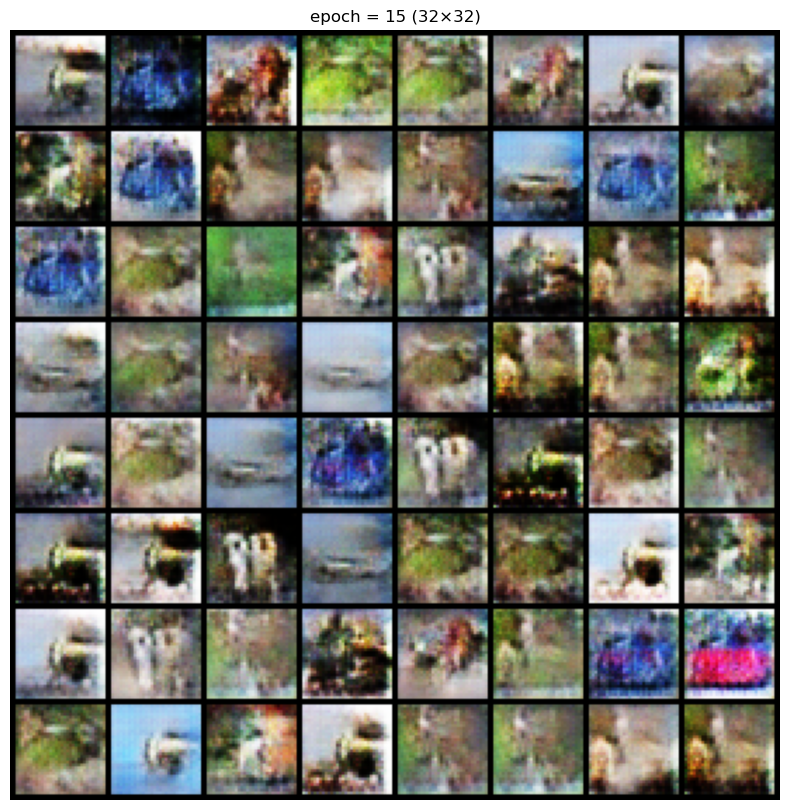

epoch [30/150] D loss: 0.6661 G loss: 3.8556


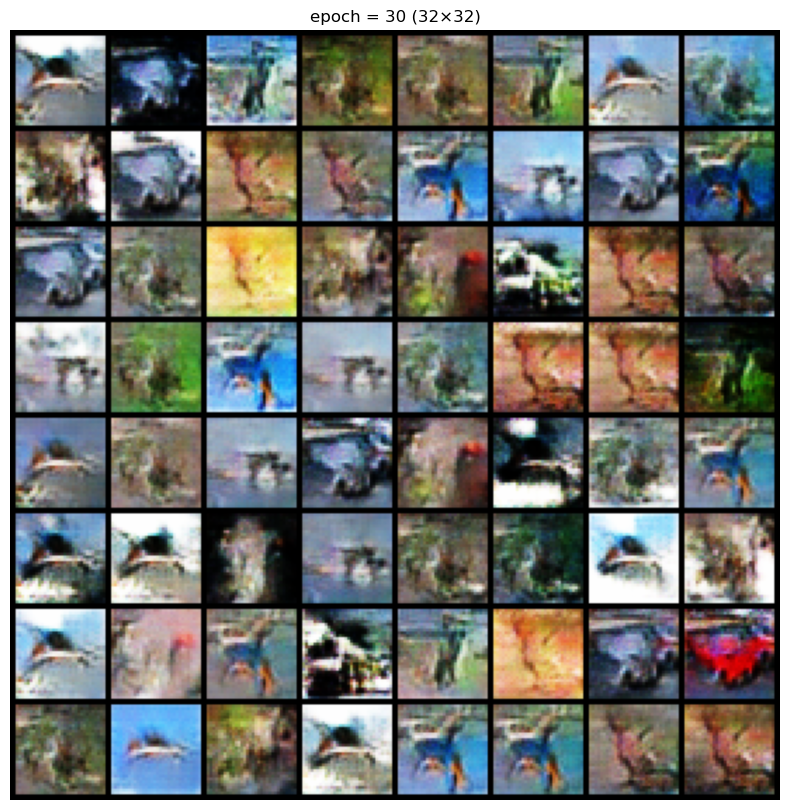

epoch [45/150] D loss: 0.6605 G loss: 2.8790


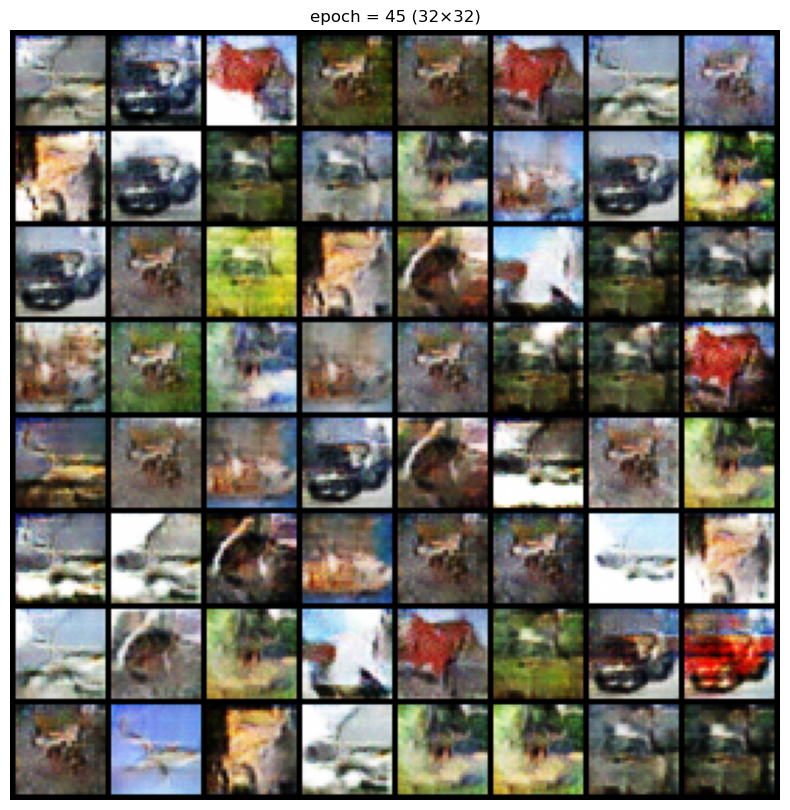

epoch [60/150] D loss: 0.5027 G loss: 3.6421


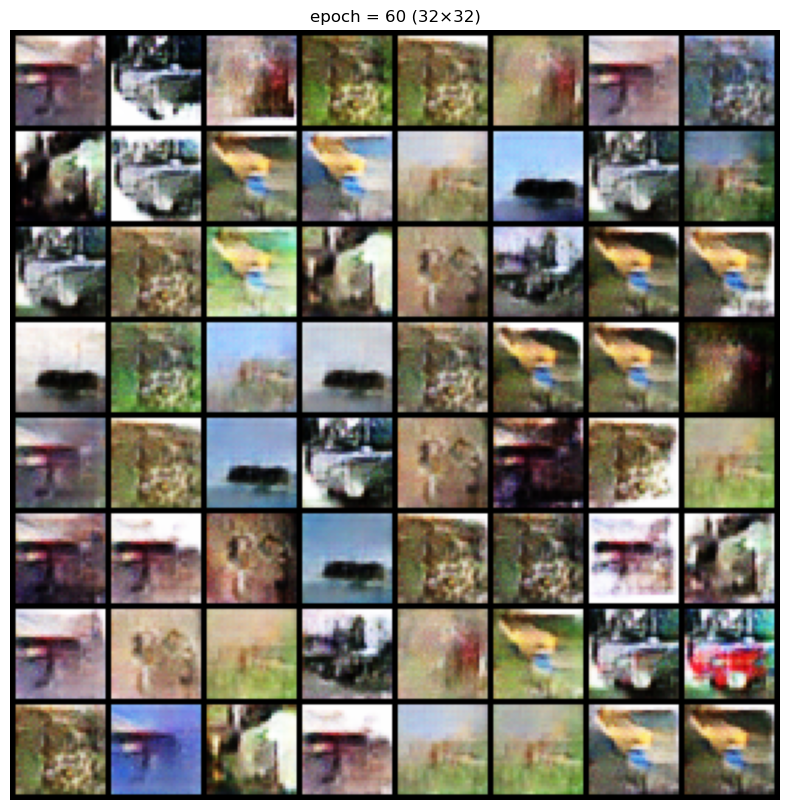

epoch [75/150] D loss: 0.5433 G loss: 3.9361


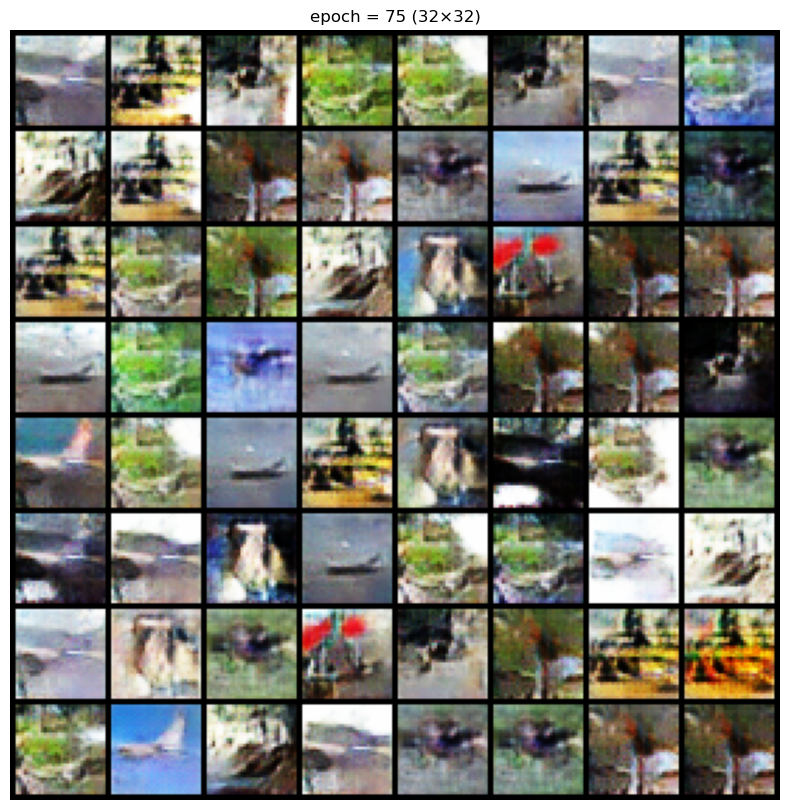

epoch [90/150] D loss: 0.9243 G loss: 7.4019


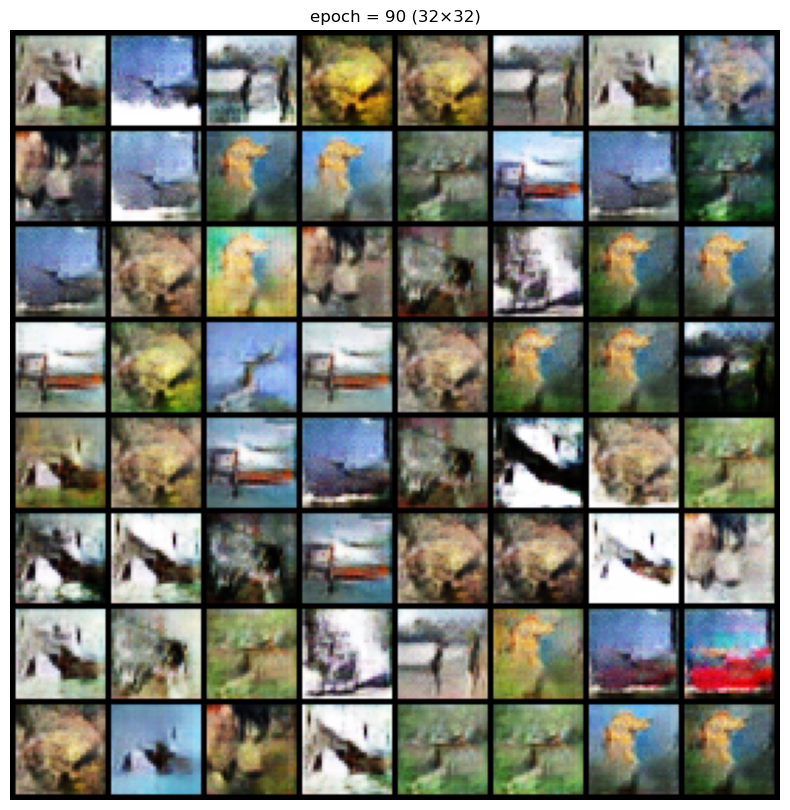

epoch [105/150] D loss: 1.1433 G loss: 8.8064


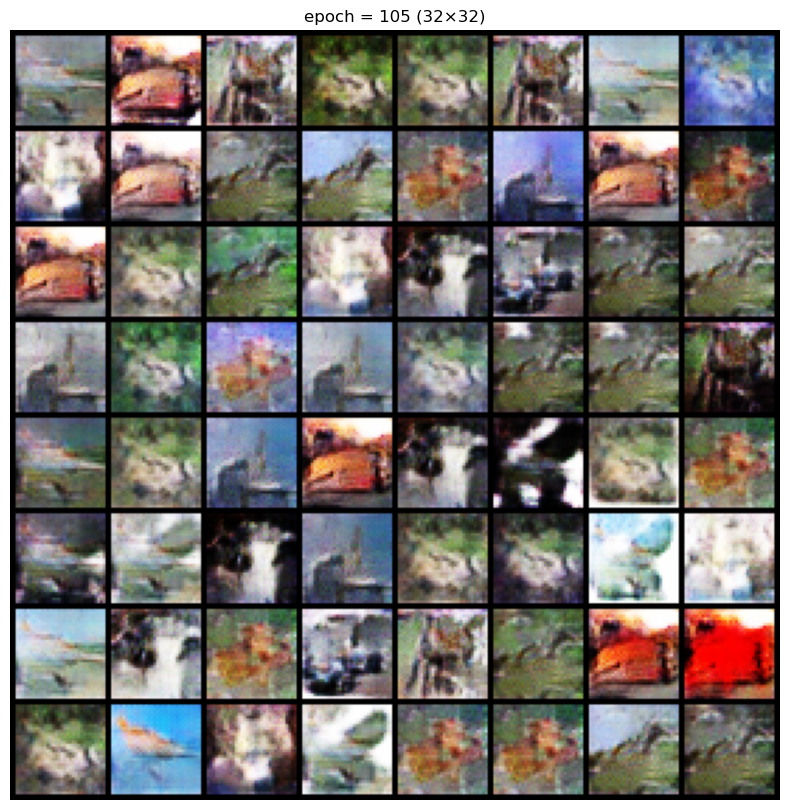

epoch [120/150] D loss: 0.4718 G loss: 3.8736


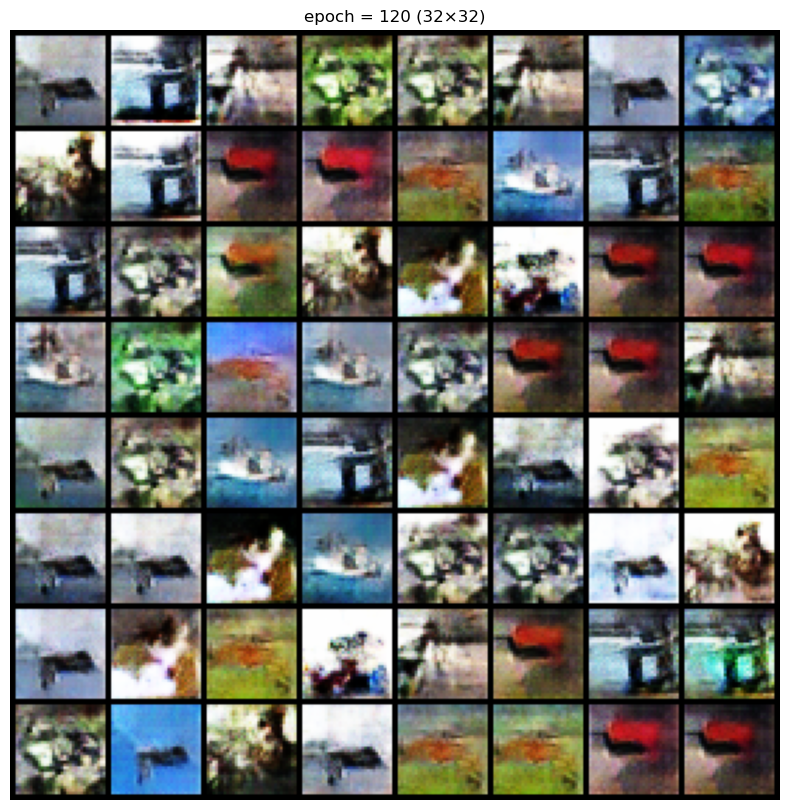

epoch [135/150] D loss: 0.5233 G loss: 3.9700


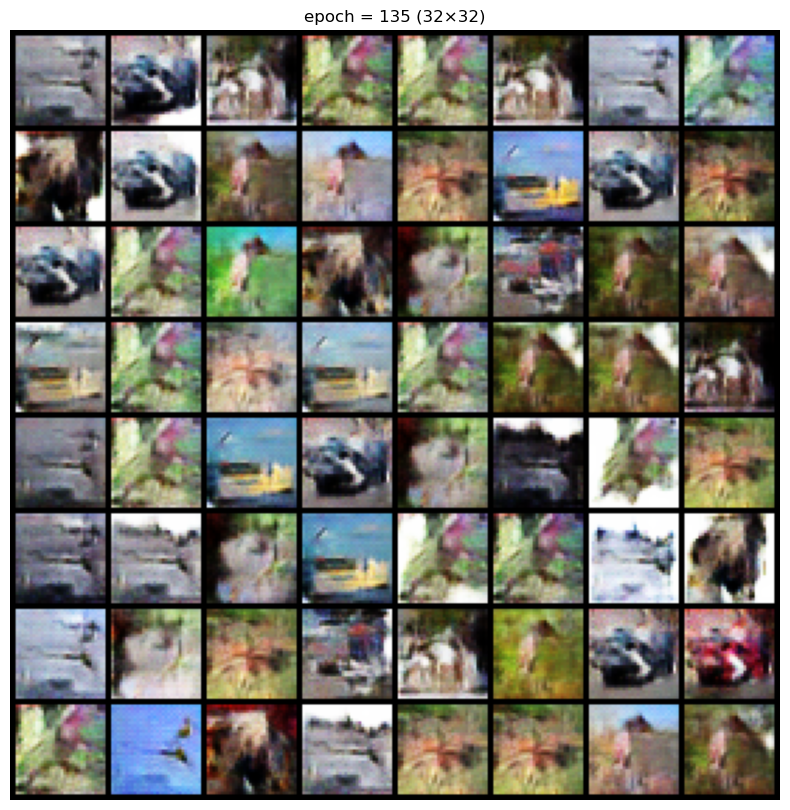

epoch [150/150] D loss: 0.5289 G loss: 3.3362


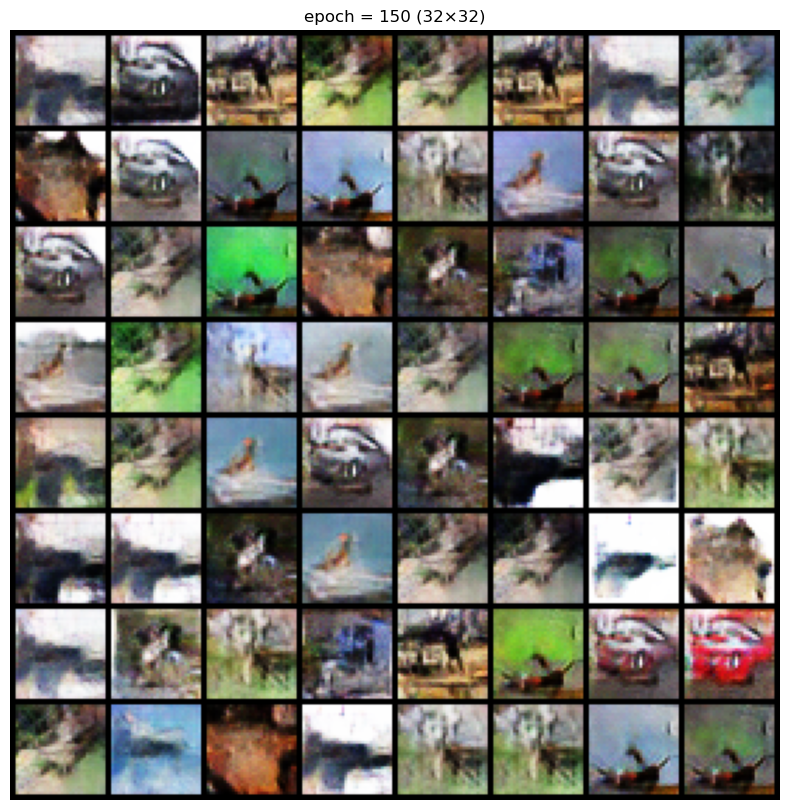

In [9]:
print(f"DCGAN ({IMAGE_SIZE}×{IMAGE_SIZE})")

generator_dcgan = Generator(noise_dimension, num_classes, label_embedding_size, IMAGE_SIZE).to(device)
discriminator_dcgan = Discriminator_DCGAN(num_classes, label_embedding_size, IMAGE_SIZE).to(device)
generator_dcgan.apply(initialize_weights)
discriminator_dcgan.apply(initialize_weights)
binary_cross_entropy_loss = nn.BCELoss()
optimizer_discriminator_dcgan = optim.Adam(discriminator_dcgan.parameters(), lr=learning_rate, betas=(beta1, 0.999))
optimizer_generator_dcgan = optim.Adam(generator_dcgan.parameters(), lr=learning_rate, betas=(beta1, 0.999))
fixed_noise_vector_dcgan = torch.randn(64, noise_dimension).to(device)
fixed_class_labels_dcgan = torch.randint(0, num_classes, (64,)).to(device)
generator_losses_dcgan = []
discriminator_losses_dcgan = []

for epoch in range(num_epochs):
    for batch_idx, (real_images_batch, real_labels_batch) in enumerate(data_loader):
        current_batch_size = real_images_batch.size(0)
        real_images_batch = real_images_batch.to(device)
        real_labels_batch = real_labels_batch.to(device)
        real_images_batch = real_images_batch + torch.randn_like(real_images_batch) * 0.05
        real_image_labels = torch.ones(current_batch_size, device=device) * 0.9
        fake_image_labels = torch.zeros(current_batch_size, device=device)
        discriminator_dcgan.zero_grad()
        real_image_predictions = discriminator_dcgan(real_images_batch, real_labels_batch)
        loss_discriminator_real = binary_cross_entropy_loss(real_image_predictions, real_image_labels)
        loss_discriminator_real.backward()
        random_noise = torch.randn(current_batch_size, noise_dimension).to(device)
        random_class_labels = torch.randint(0, num_classes, (current_batch_size,)).to(device)
        generated_fake_images = generator_dcgan(random_noise, random_class_labels)
        fake_image_predictions = discriminator_dcgan(generated_fake_images.detach(), random_class_labels)
        loss_discriminator_fake = binary_cross_entropy_loss(fake_image_predictions, fake_image_labels)
        loss_discriminator_fake.backward()
        total_discriminator_loss = loss_discriminator_real + loss_discriminator_fake
        optimizer_discriminator_dcgan.step()
        generator_dcgan.zero_grad()
        fake_predictions_for_generator = discriminator_dcgan(generated_fake_images, random_class_labels)
        loss_generator = binary_cross_entropy_loss(fake_predictions_for_generator, torch.ones(current_batch_size, device=device))
        loss_generator.backward()
        optimizer_generator_dcgan.step()
        
        if batch_idx % 100 == 0:
            generator_losses_dcgan.append(loss_generator.item())
            discriminator_losses_dcgan.append(total_discriminator_loss.item())
    
    if (epoch + 1) % 15 == 0:
        print(f'epoch [{epoch+1}/{num_epochs}] '
              f'D loss: {total_discriminator_loss.item():.4f} '
              f'G loss: {loss_generator.item():.4f}')
        
        with torch.no_grad():
            generated_samples = generator_dcgan(fixed_noise_vector_dcgan, fixed_class_labels_dcgan).detach()
            display_images(generated_samples, f'epoch = {epoch+1} ({IMAGE_SIZE}×{IMAGE_SIZE})')

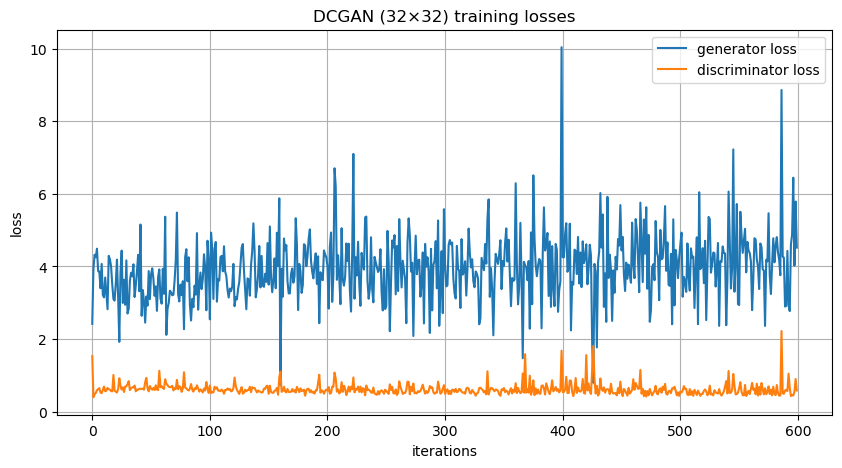

In [10]:
plot_training_losses(generator_losses_dcgan, discriminator_losses_dcgan, f'DCGAN ({IMAGE_SIZE}×{IMAGE_SIZE})')

training WGAN (32×32)
epoch [15/150] critic loss: -1.0714 G loss: 0.5619


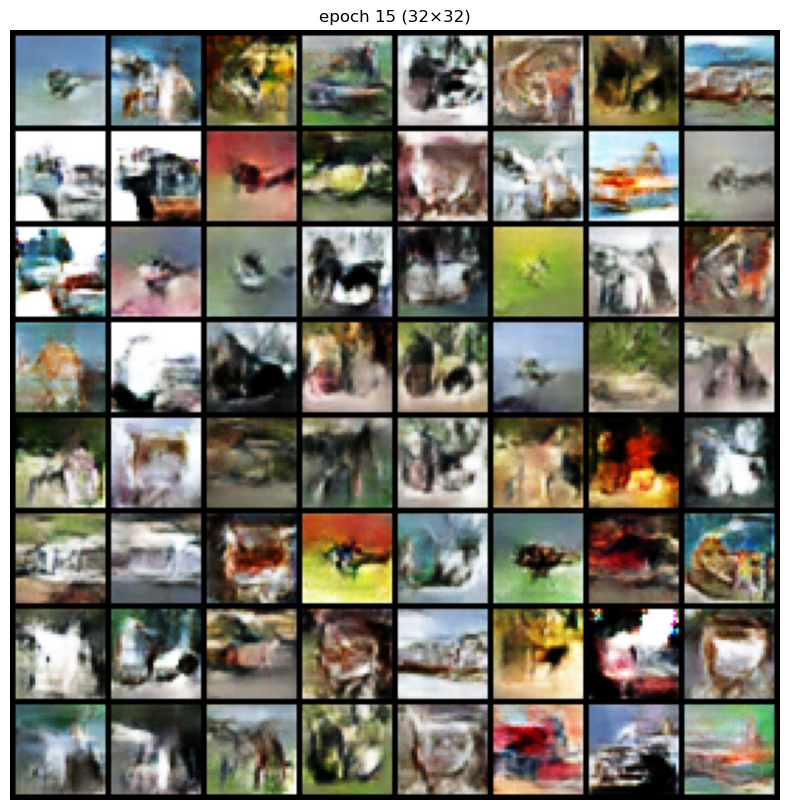

epoch [30/150] critic loss: -0.8087 G loss: 0.5797


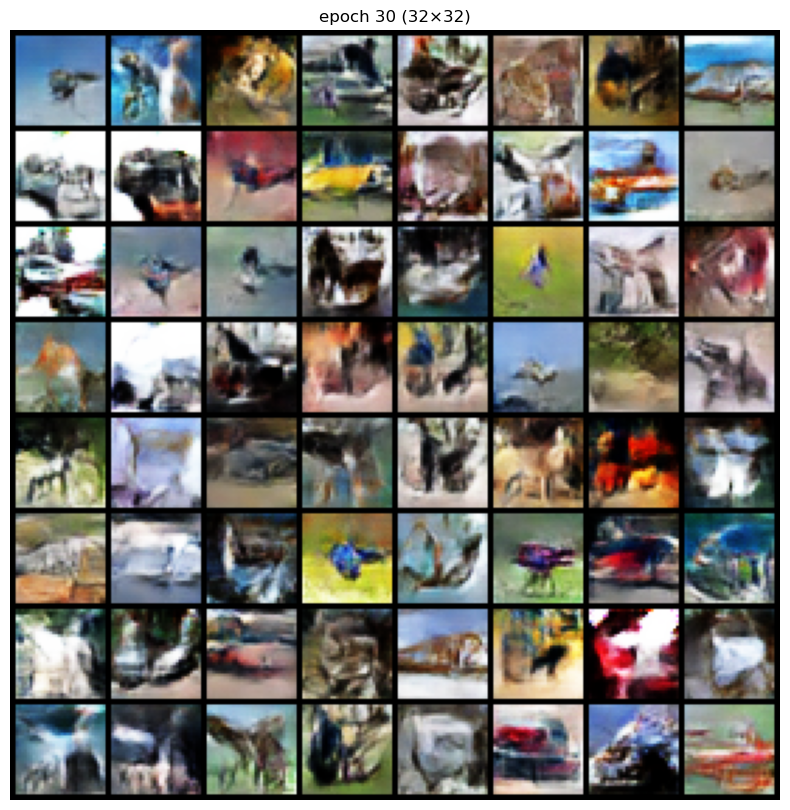

epoch [45/150] critic loss: -0.7158 G loss: 0.5109


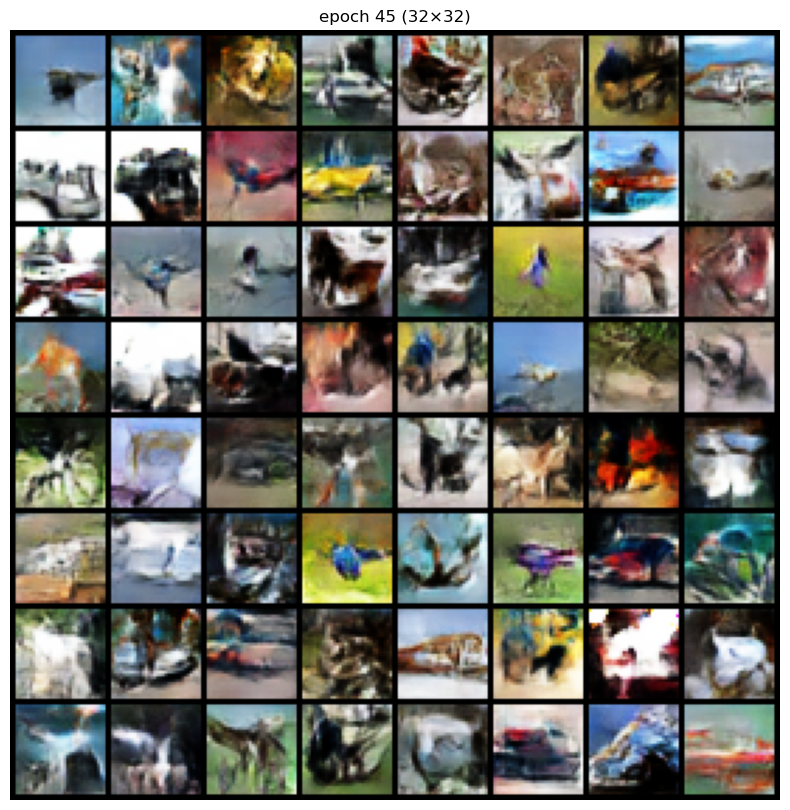

epoch [60/150] critic loss: -0.5284 G loss: 0.2563


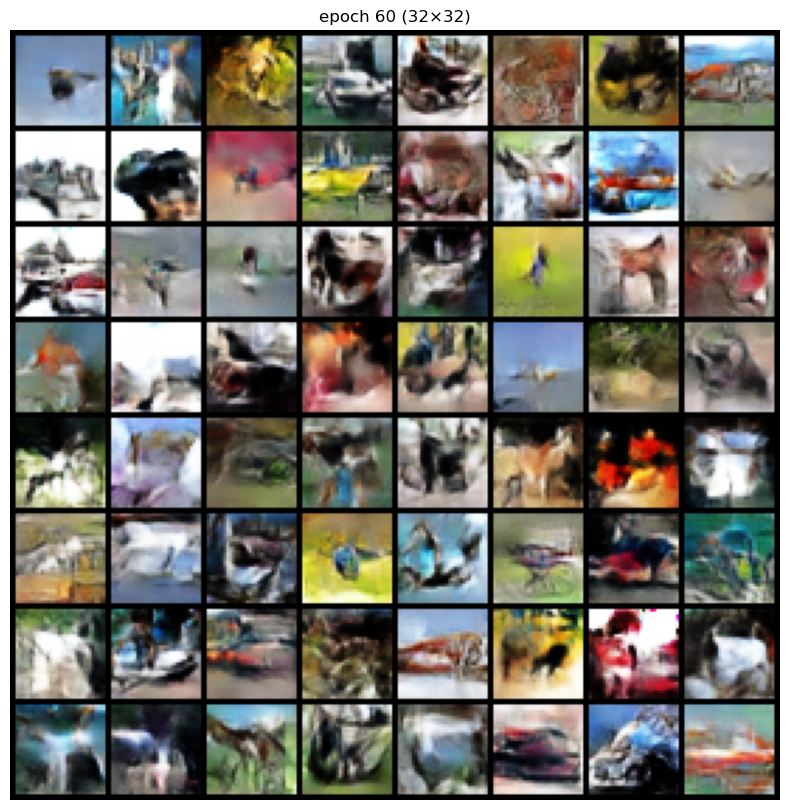

epoch [75/150] critic loss: -1.3698 G loss: 0.6659


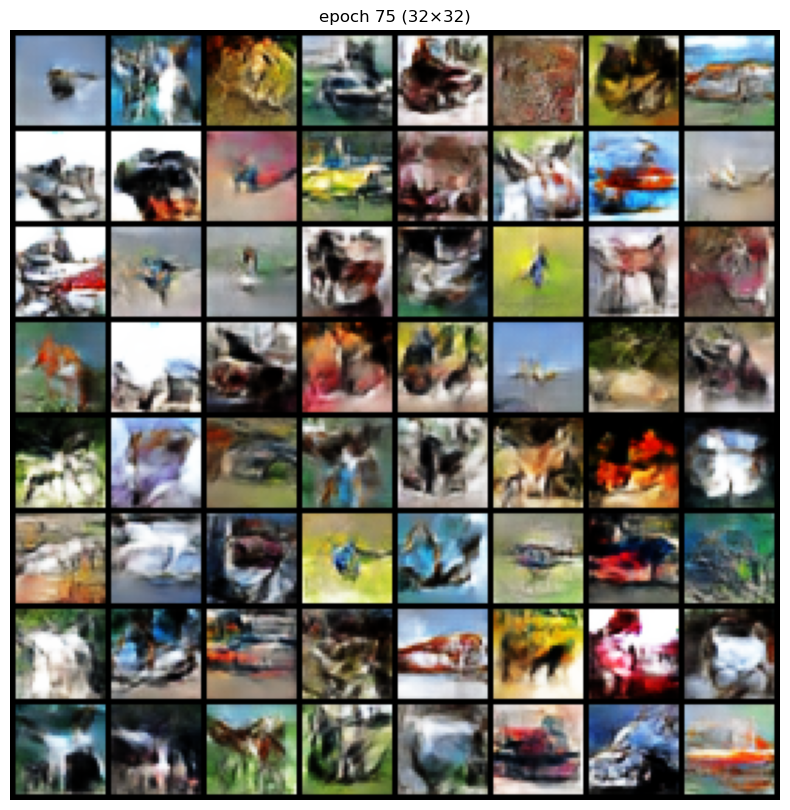

epoch [90/150] critic loss: -0.2445 G loss: 0.4656


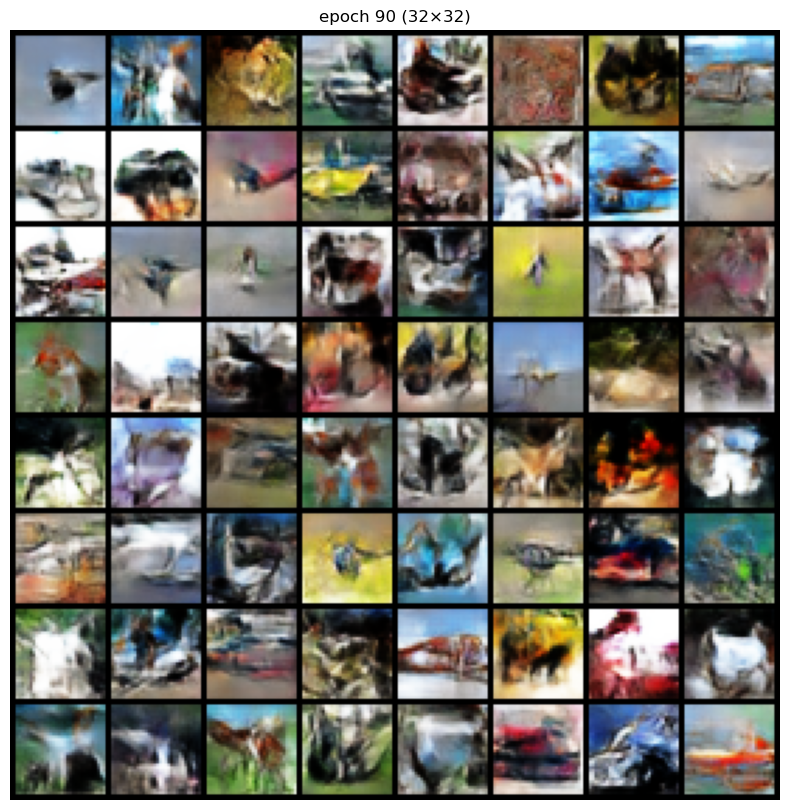

epoch [105/150] critic loss: -0.5823 G loss: 0.6611


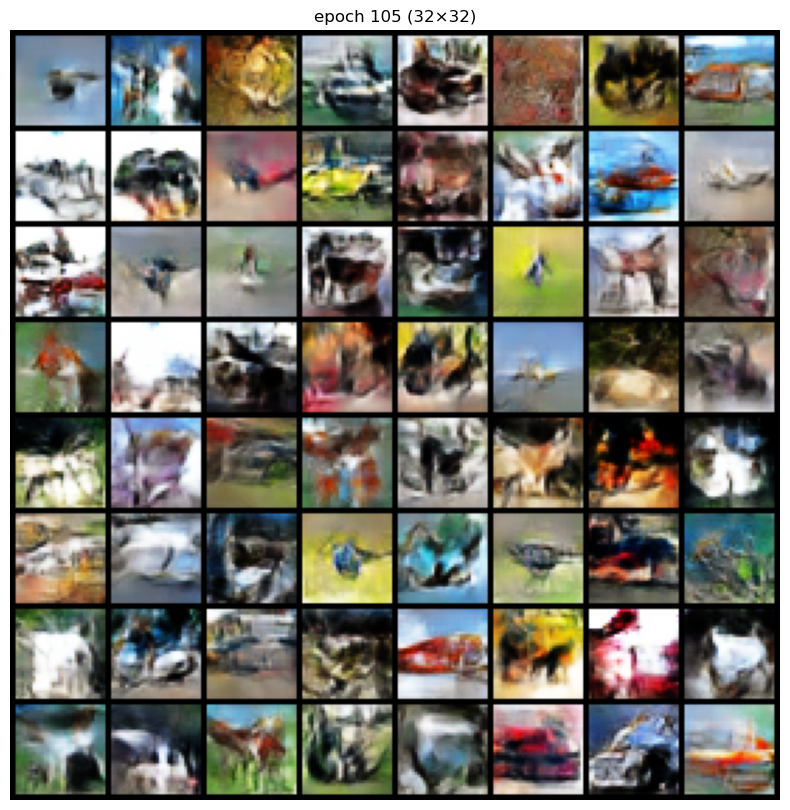

epoch [120/150] critic loss: -0.0980 G loss: 0.3722


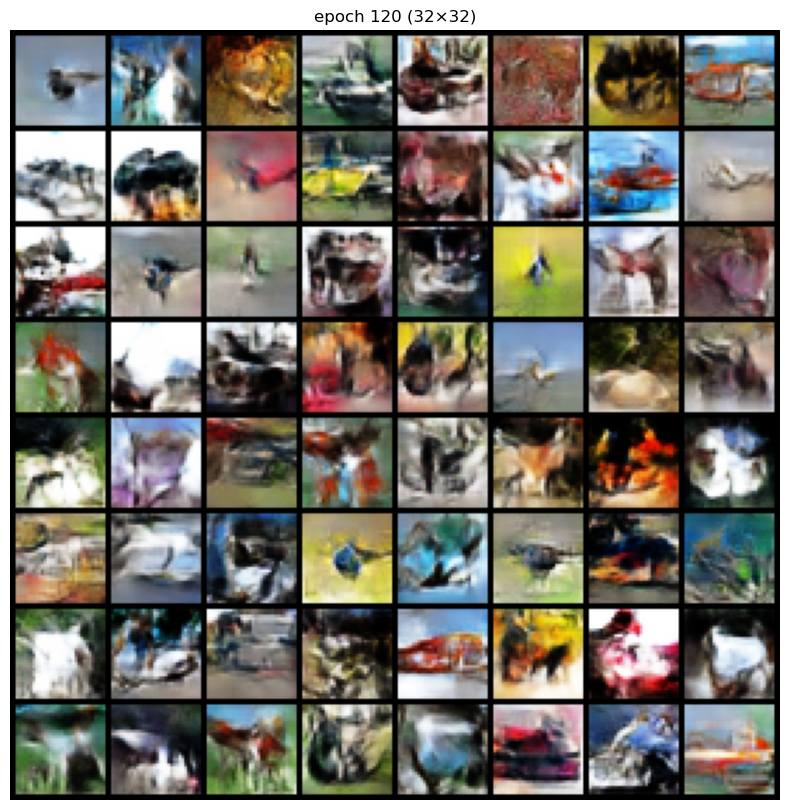

epoch [135/150] critic loss: -0.4032 G loss: 0.4648


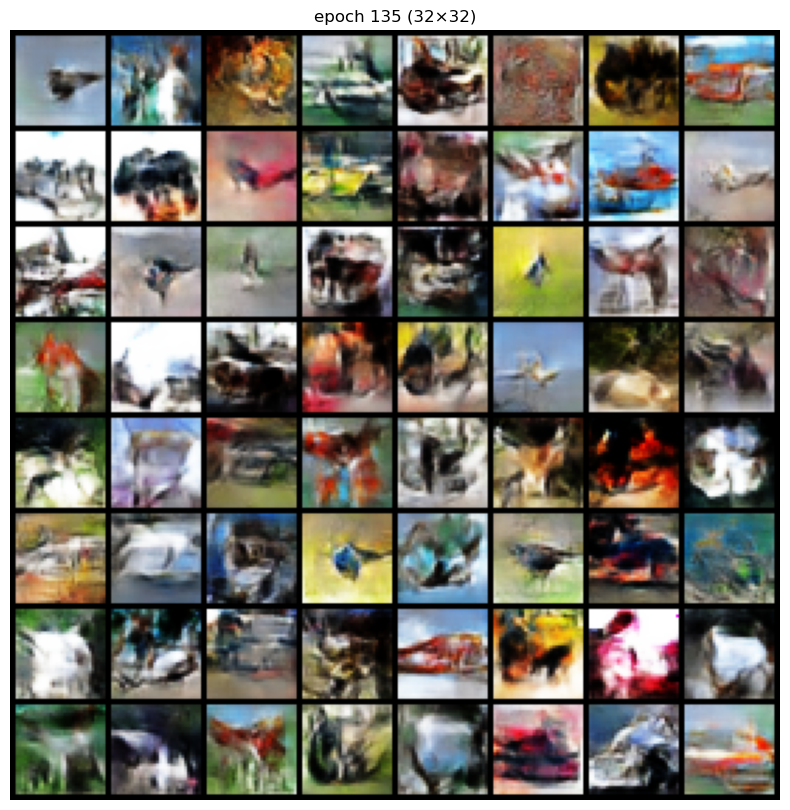

epoch [150/150] critic loss: -0.3479 G loss: 0.2260


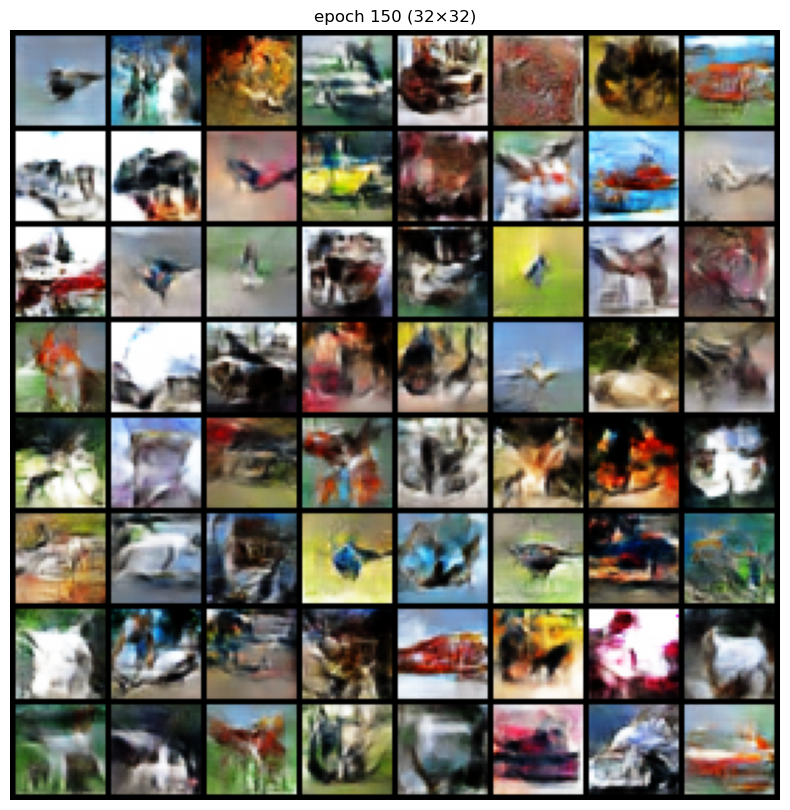

In [11]:
print(f"training WGAN ({IMAGE_SIZE}×{IMAGE_SIZE})")
generator_wgan = Generator(noise_dimension, num_classes, label_embedding_size, IMAGE_SIZE).to(device)
critic_wgan = Discriminator_WGAN(num_classes, label_embedding_size, IMAGE_SIZE).to(device)
generator_wgan.apply(initialize_weights)
critic_wgan.apply(initialize_weights)
optimizer_critic_wgan = optim.Adam(critic_wgan.parameters(), lr=learning_rate, betas=(beta1, 0.999))
optimizer_generator_wgan = optim.Adam(generator_wgan.parameters(), lr=learning_rate, betas=(beta1, 0.999))
fixed_noise_vector_wgan = torch.randn(64, noise_dimension).to(device)
fixed_class_labels_wgan = torch.randint(0, num_classes, (64,)).to(device)
generator_losses_wgan = []
critic_losses_wgan = []
for epoch in range(num_epochs):
    for batch_idx, (real_images_batch, real_labels_batch) in enumerate(data_loader):
        current_batch_size = real_images_batch.size(0)
        real_images_batch = real_images_batch.to(device)
        real_labels_batch = real_labels_batch.to(device)
        for critic_iteration in range(critic_iterations):
            critic_wgan.zero_grad()
            real_scores = critic_wgan(real_images_batch, real_labels_batch)
            random_noise = torch.randn(current_batch_size, noise_dimension).to(device)
            random_class_labels = torch.randint(0, num_classes, (current_batch_size,)).to(device)
            generated_fake_images = generator_wgan(random_noise, random_class_labels)
            fake_scores = critic_wgan(generated_fake_images.detach(), random_class_labels)
            critic_loss = -(real_scores.mean() - fake_scores.mean())
            critic_loss.backward()
            optimizer_critic_wgan.step()
            for parameter in critic_wgan.parameters():
                parameter.data.clamp_(-weight_clip_value, weight_clip_value)
        
        generator_wgan.zero_grad()
        random_noise = torch.randn(current_batch_size, noise_dimension).to(device)
        random_class_labels = torch.randint(0, num_classes, (current_batch_size,)).to(device)
        generated_fake_images = generator_wgan(random_noise, random_class_labels)
        fake_scores_for_generator = critic_wgan(generated_fake_images, random_class_labels)
        generator_loss = -fake_scores_for_generator.mean()
        generator_loss.backward()
        optimizer_generator_wgan.step()
        if batch_idx % 100 == 0:
            generator_losses_wgan.append(generator_loss.item())
            critic_losses_wgan.append(critic_loss.item())
    if (epoch + 1) % 15 == 0:
        print(f'epoch [{epoch+1}/{num_epochs}] '
              f'critic loss: {critic_loss.item():.4f} '
              f'G loss: {generator_loss.item():.4f}')
        
        with torch.no_grad():
            generated_samples = generator_wgan(fixed_noise_vector_wgan, fixed_class_labels_wgan).detach()
            display_images(generated_samples, f'epoch {epoch+1} ({IMAGE_SIZE}×{IMAGE_SIZE})')

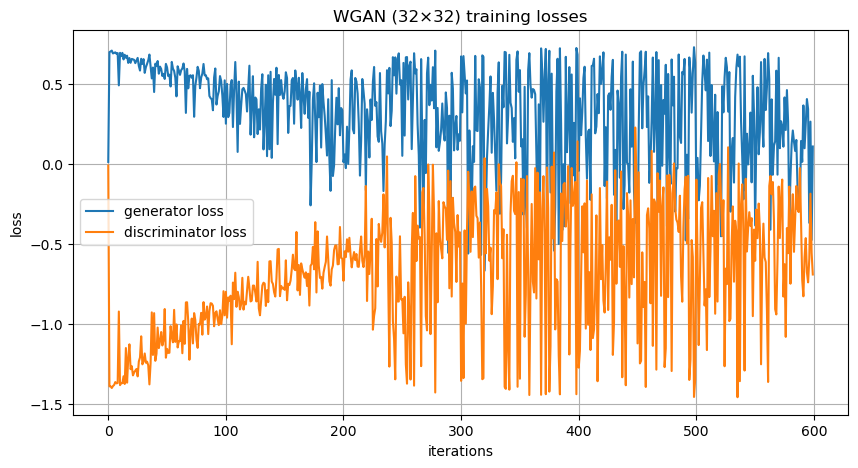

In [12]:
plot_training_losses(generator_losses_wgan, critic_losses_wgan, f'WGAN ({IMAGE_SIZE}×{IMAGE_SIZE})')

training ACGAN (32×32)
epoch [15/150] D Loss: 0.7066 G Loss: 3.5444


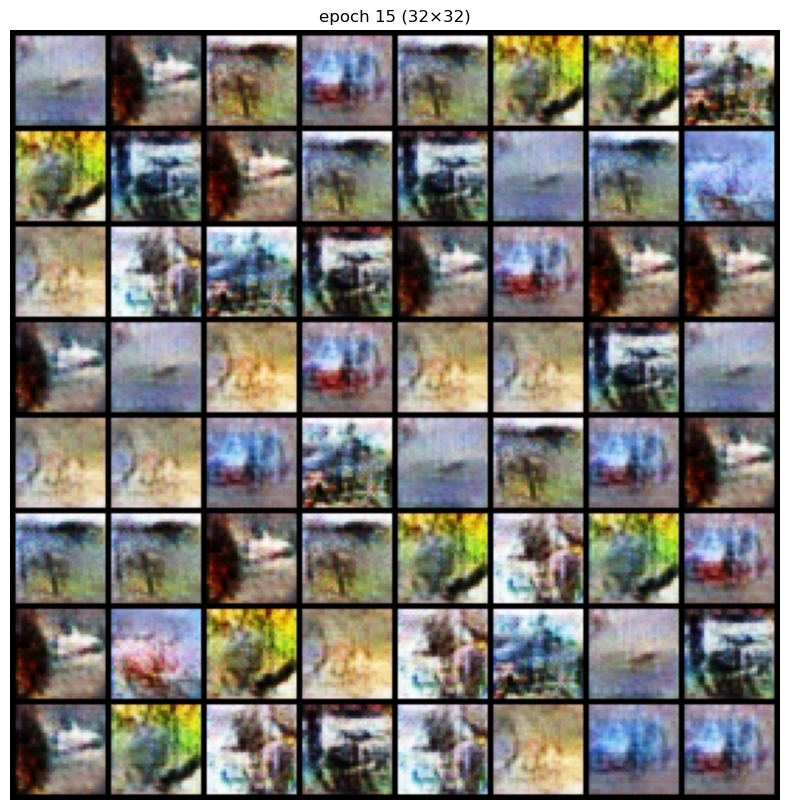

epoch [30/150] D Loss: 0.4494 G Loss: 4.1306


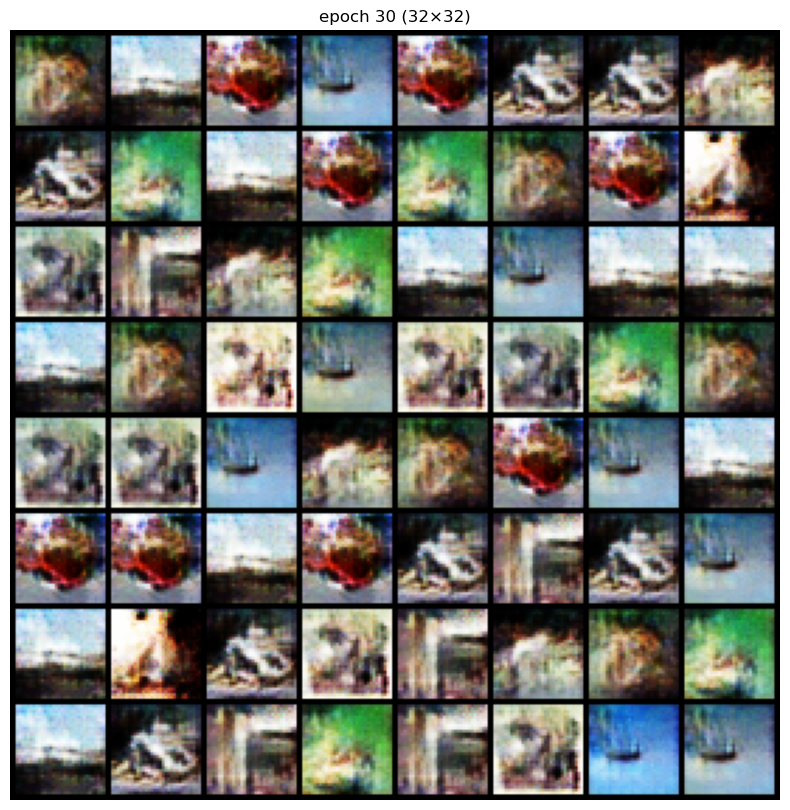

epoch [45/150] D Loss: 0.3432 G Loss: 4.0895


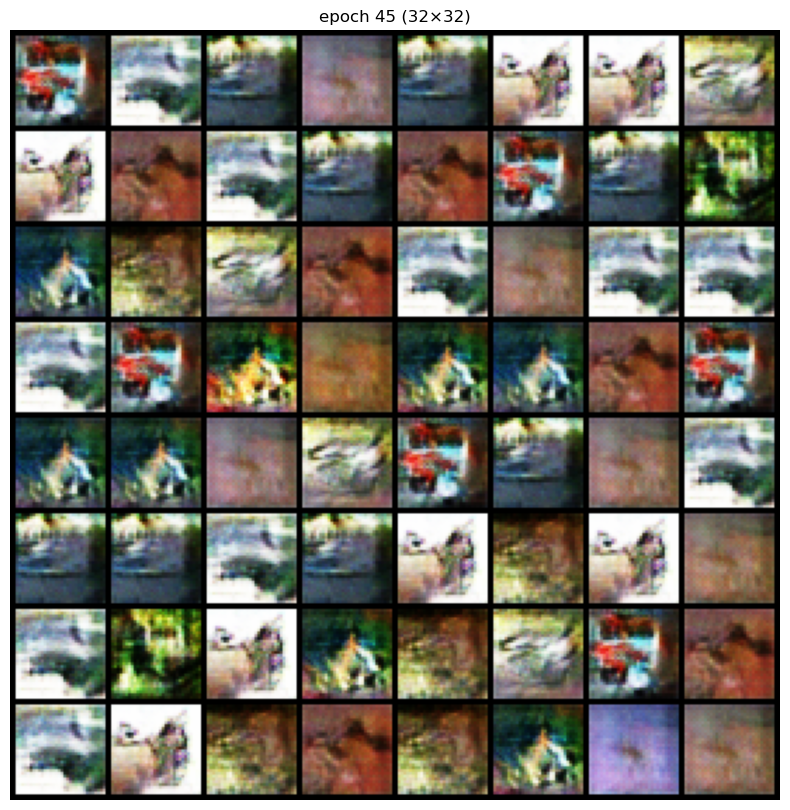

epoch [60/150] D Loss: 0.5168 G Loss: 2.2283


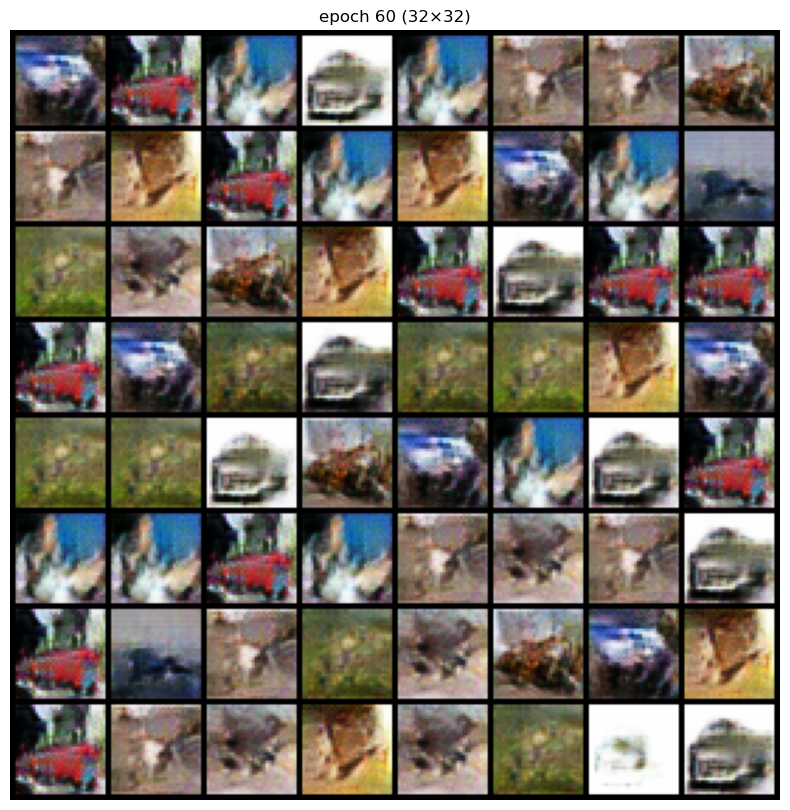

epoch [75/150] D Loss: 0.4261 G Loss: 4.2886


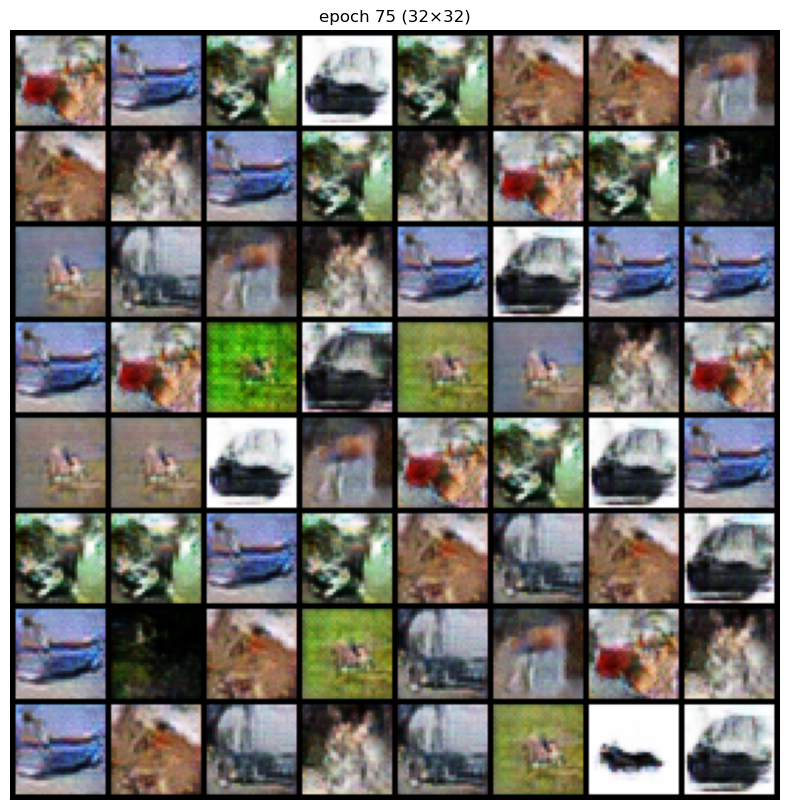

epoch [90/150] D Loss: 0.4842 G Loss: 5.3101


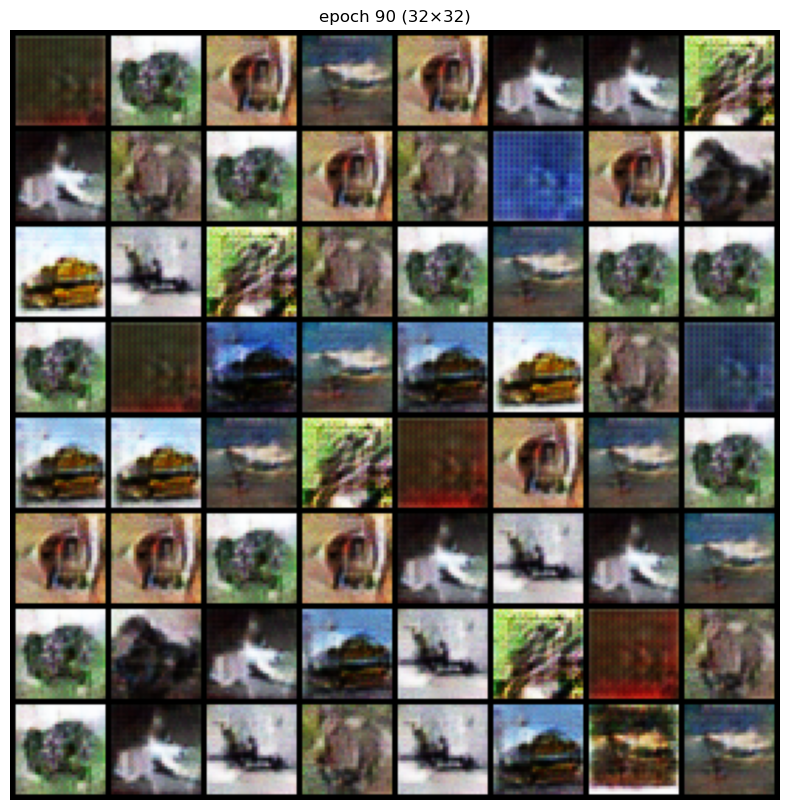

epoch [105/150] D Loss: 0.2696 G Loss: 3.9116


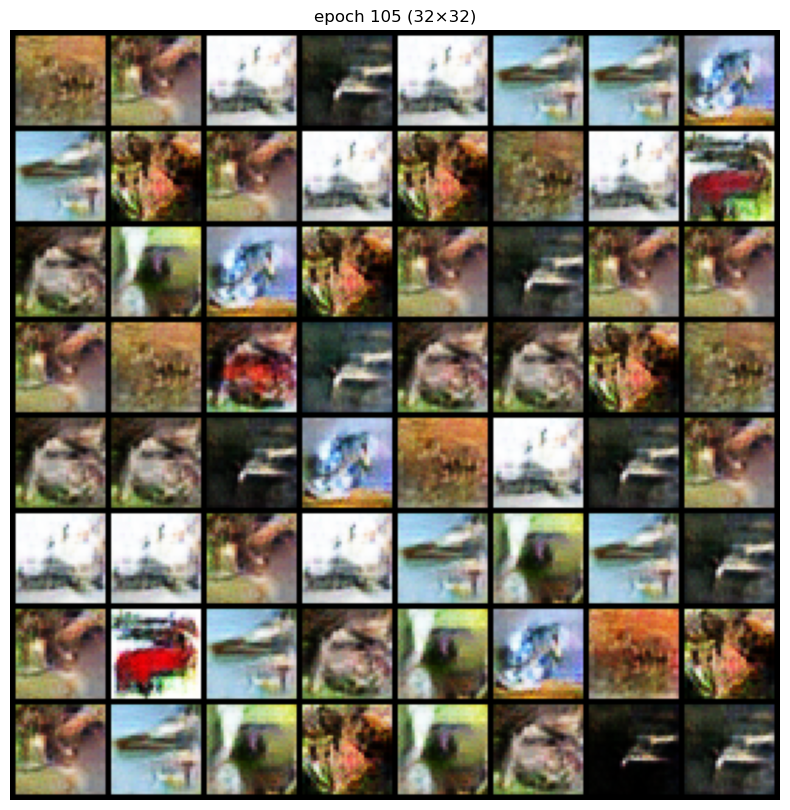

epoch [120/150] D Loss: 0.3999 G Loss: 4.4466


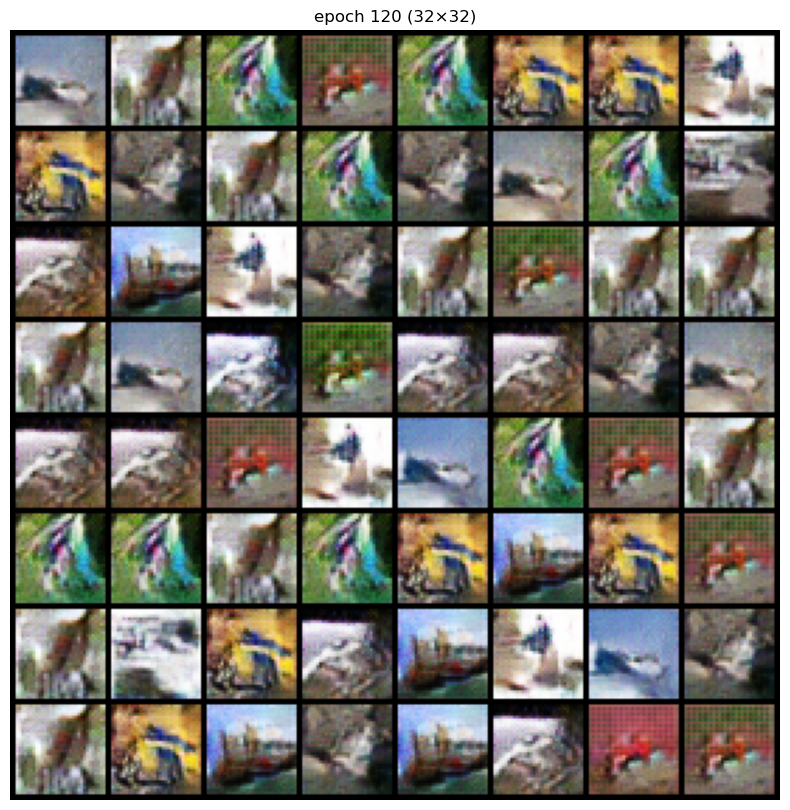

epoch [135/150] D Loss: 0.3265 G Loss: 5.1220


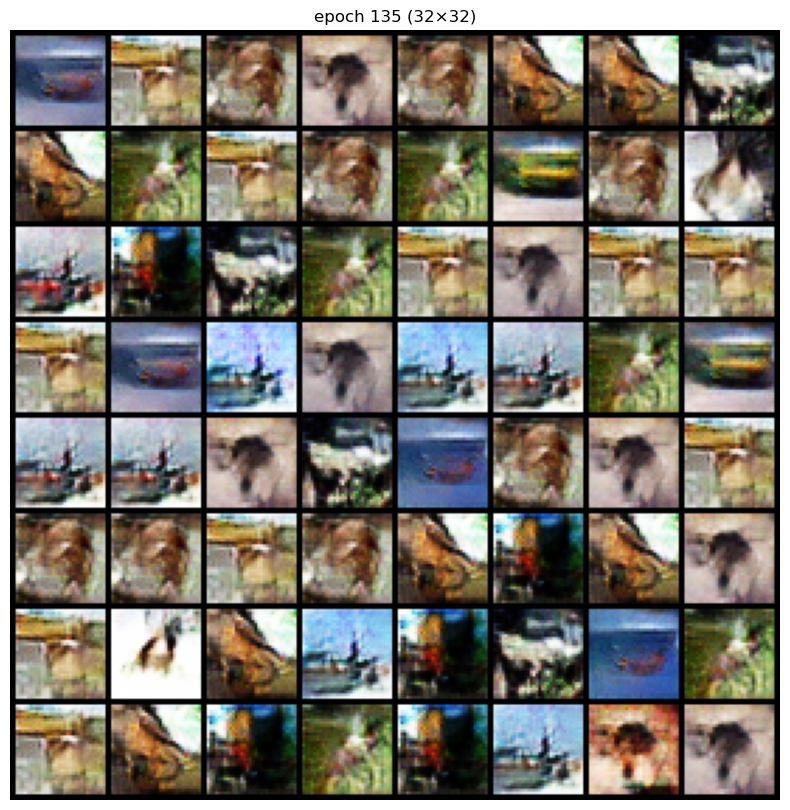

epoch [150/150] D Loss: 0.3185 G Loss: 3.9832


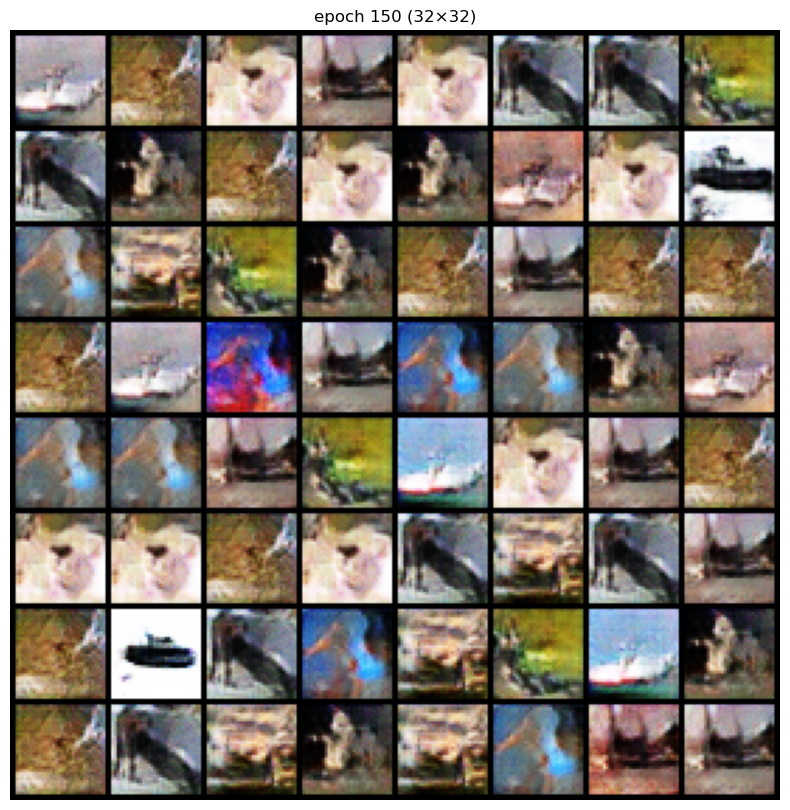

In [13]:
print(f"training ACGAN ({IMAGE_SIZE}×{IMAGE_SIZE})")

generator_acgan = Generator(noise_dimension, num_classes, label_embedding_size, IMAGE_SIZE).to(device)
discriminator_acgan = Discriminator_ACGAN(num_classes, IMAGE_SIZE).to(device)
generator_acgan.apply(initialize_weights)
discriminator_acgan.apply(initialize_weights)
adversarial_loss_criterion = nn.BCELoss()
auxiliary_loss_criterion = nn.CrossEntropyLoss()
optimizer_discriminator_acgan = optim.Adam(discriminator_acgan.parameters(), lr=learning_rate, betas=(beta1, 0.999))
optimizer_generator_acgan = optim.Adam(generator_acgan.parameters(), lr=learning_rate, betas=(beta1, 0.999))
fixed_noise_vector_acgan = torch.randn(64, noise_dimension).to(device)
fixed_class_labels_acgan = torch.randint(0, num_classes, (64,)).to(device)
generator_losses_acgan = []
discriminator_losses_acgan = []
for epoch in range(num_epochs):
    for batch_idx, (real_images_batch, real_labels_batch) in enumerate(data_loader):
        current_batch_size = real_images_batch.size(0)
        real_images_batch = real_images_batch.to(device)
        real_labels_batch = real_labels_batch.to(device)
        real_images_batch = real_images_batch + torch.randn_like(real_images_batch) * 0.05
        real_image_labels = torch.ones(current_batch_size, device=device) * 0.9
        fake_image_labels = torch.zeros(current_batch_size, device=device)
        discriminator_acgan.zero_grad()
        real_predictions, real_class_predictions = discriminator_acgan(real_images_batch)
        adversarial_loss_real = adversarial_loss_criterion(real_predictions, real_image_labels)
        auxiliary_loss_real = auxiliary_loss_criterion(real_class_predictions, real_labels_batch)
        random_noise = torch.randn(current_batch_size, noise_dimension).to(device)
        random_class_labels = torch.randint(0, num_classes, (current_batch_size,)).to(device)
        generated_fake_images = generator_acgan(random_noise, random_class_labels)
        fake_predictions, fake_class_predictions = discriminator_acgan(generated_fake_images.detach())
        adversarial_loss_fake = adversarial_loss_criterion(fake_predictions, fake_image_labels)
        auxiliary_loss_fake = auxiliary_loss_criterion(fake_class_predictions, random_class_labels)
        discriminator_loss = (adversarial_loss_real + adversarial_loss_fake) / 2 + \
                            (auxiliary_loss_real + auxiliary_loss_fake) / 2
        discriminator_loss.backward()
        optimizer_discriminator_acgan.step()
        generator_acgan.zero_grad()
        fake_predictions_for_generator, fake_class_predictions_for_generator = discriminator_acgan(generated_fake_images)
        adversarial_loss_generator = adversarial_loss_criterion(fake_predictions_for_generator, torch.ones(current_batch_size, device=device))
        auxiliary_loss_generator = auxiliary_loss_criterion(fake_class_predictions_for_generator, random_class_labels)
        generator_loss = adversarial_loss_generator + auxiliary_loss_generator
        generator_loss.backward()
        optimizer_generator_acgan.step()
        if batch_idx % 100 == 0:
            generator_losses_acgan.append(generator_loss.item())
            discriminator_losses_acgan.append(discriminator_loss.item())
    
    if (epoch + 1) % 15 == 0:
        print(f'epoch [{epoch+1}/{num_epochs}] '
              f'D Loss: {discriminator_loss.item():.4f} '
              f'G Loss: {generator_loss.item():.4f}')
        
        with torch.no_grad():
            generated_samples = generator_acgan(fixed_noise_vector_acgan, fixed_class_labels_acgan).detach()
            display_images(generated_samples, f'epoch {epoch+1} ({IMAGE_SIZE}×{IMAGE_SIZE})')


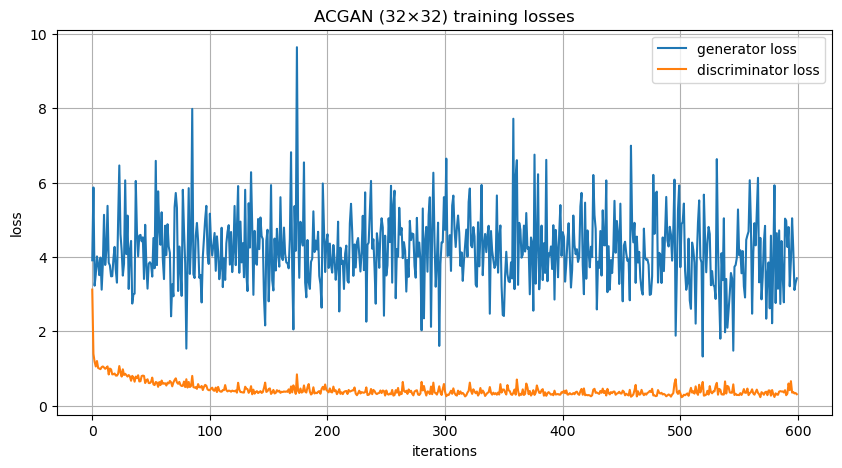

In [14]:
plot_training_losses(generator_losses_acgan, discriminator_losses_acgan, f'ACGAN ({IMAGE_SIZE}×{IMAGE_SIZE})')

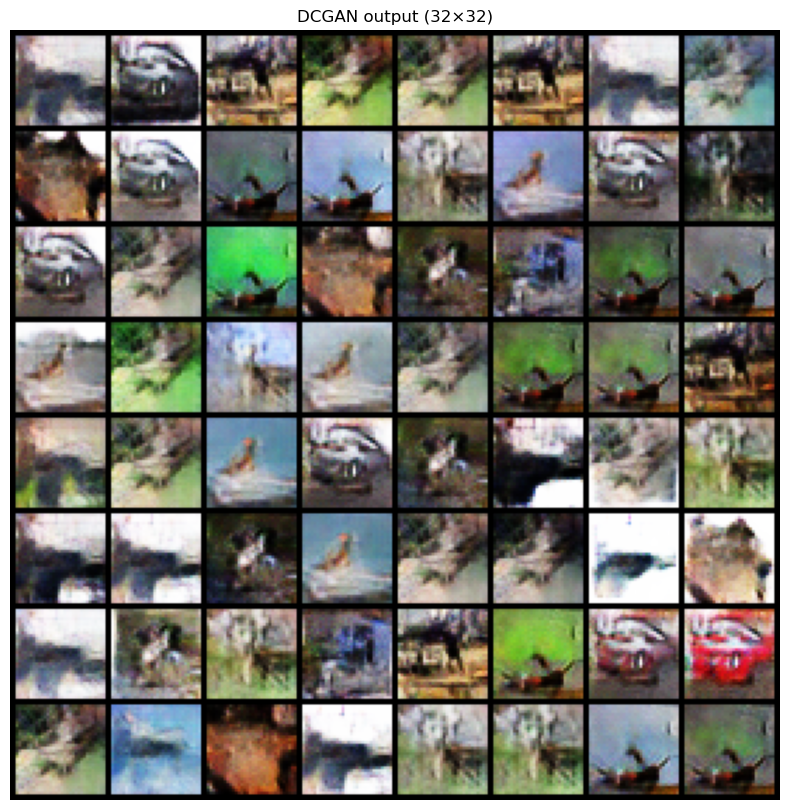

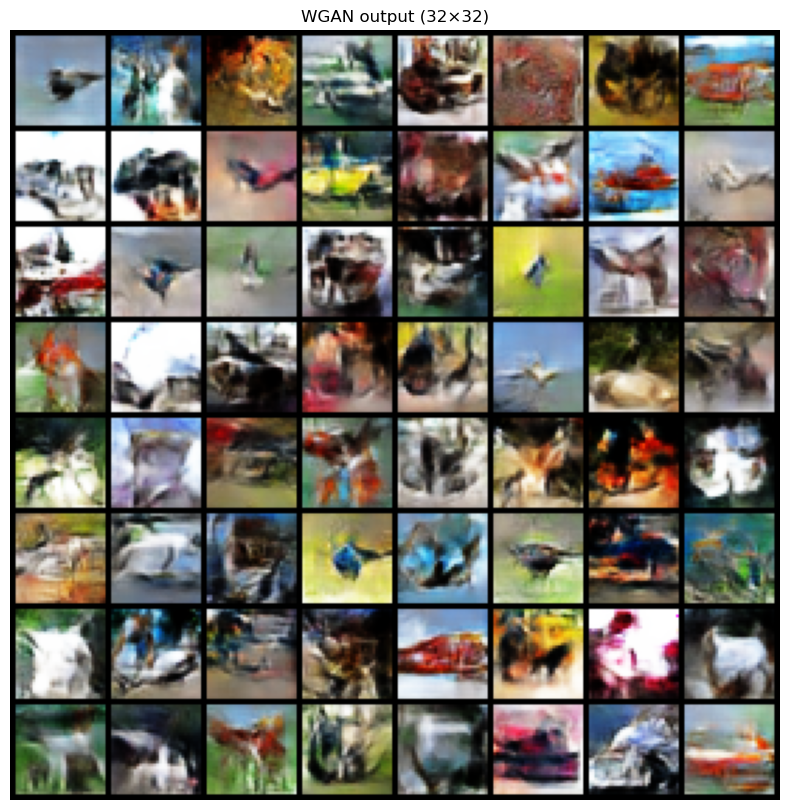

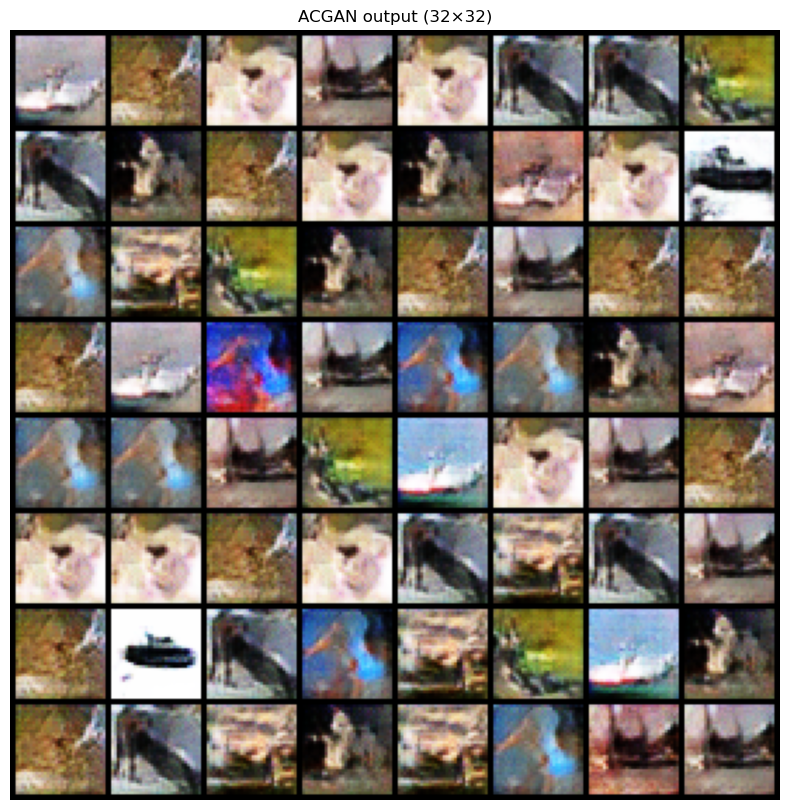

In [15]:
with torch.no_grad():
    dcgan_final_samples = generator_dcgan(fixed_noise_vector_dcgan, fixed_class_labels_dcgan).detach()
    display_images(dcgan_final_samples, f'DCGAN output ({IMAGE_SIZE}×{IMAGE_SIZE})')
    
    wgan_final_samples = generator_wgan(fixed_noise_vector_wgan, fixed_class_labels_wgan).detach()
    display_images(wgan_final_samples, f'WGAN output ({IMAGE_SIZE}×{IMAGE_SIZE})')
    
    acgan_final_samples = generator_acgan(fixed_noise_vector_acgan, fixed_class_labels_acgan).detach()
    display_images(acgan_final_samples, f'ACGAN output ({IMAGE_SIZE}×{IMAGE_SIZE})')

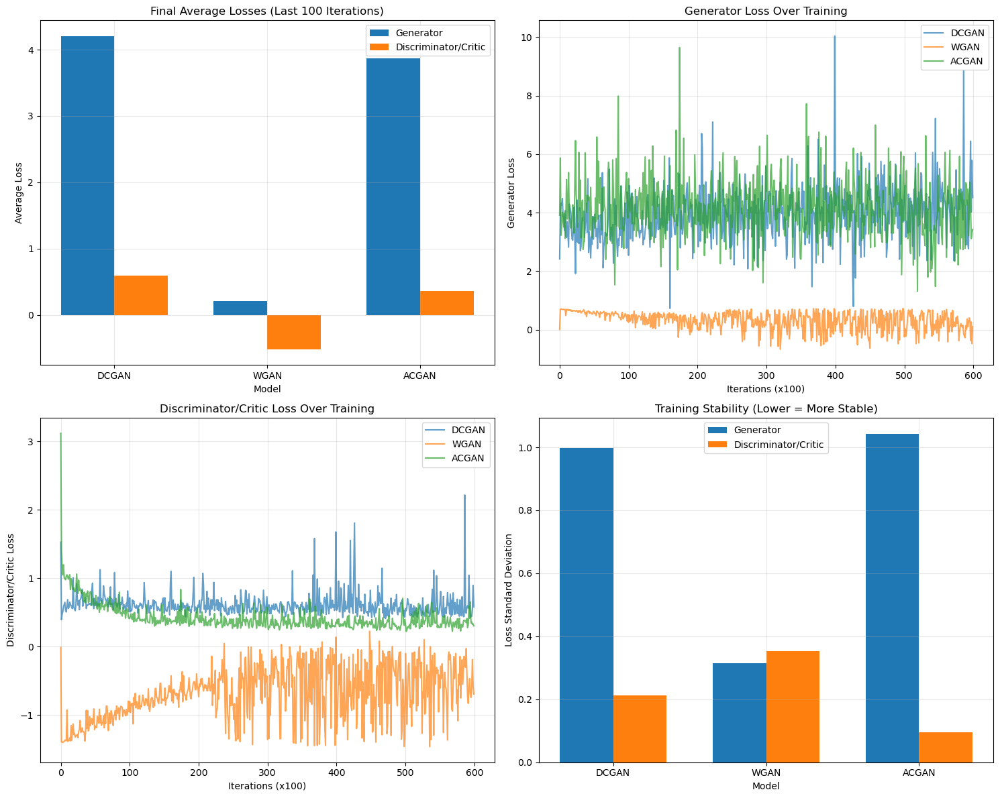

model      generator loss  discriminator loss std of generator loss
--------------------------------------------------
DCGAN      4.2062          0.5894          0.9989         
WGAN       0.2038          -0.5187         0.3139         
ACGAN      3.8744          0.3643          1.0421         


In [16]:
model_names = ['DCGAN', 'WGAN', 'ACGAN']

final_avg_gen_loss = [
    np.mean(generator_losses_dcgan[-100:]),
    np.mean(generator_losses_wgan[-100:]),
    np.mean(generator_losses_acgan[-100:])
]

final_avg_disc_loss = [
    np.mean(discriminator_losses_dcgan[-100:]),
    np.mean(critic_losses_wgan[-100:]),
    np.mean(discriminator_losses_acgan[-100:])
]

gen_loss_std = [
    np.std(generator_losses_dcgan[-100:]),
    np.std(generator_losses_wgan[-100:]),
    np.std(generator_losses_acgan[-100:])
]

disc_loss_std = [
    np.std(discriminator_losses_dcgan[-100:]),
    np.std(critic_losses_wgan[-100:]),
    np.std(discriminator_losses_acgan[-100:])
]

fig, axes = plt.subplots(2, 2, figsize=(15, 12))
x_positions = np.arange(len(model_names))
bar_width = 0.35

axes[0, 0].bar(x_positions - bar_width/2, final_avg_gen_loss, bar_width, label='Generator')
axes[0, 0].bar(x_positions + bar_width/2, final_avg_disc_loss, bar_width, label='Discriminator/Critic')
axes[0, 0].set_xlabel('Model')
axes[0, 0].set_ylabel('Average Loss')
axes[0, 0].set_title('Final Average Losses (Last 100 Iterations)')
axes[0, 0].set_xticks(x_positions)
axes[0, 0].set_xticklabels(model_names)
axes[0, 0].legend()
axes[0, 0].grid(True, alpha=0.3)

axes[0, 1].plot(generator_losses_dcgan, label='DCGAN', alpha=0.7)
axes[0, 1].plot(generator_losses_wgan, label='WGAN', alpha=0.7)
axes[0, 1].plot(generator_losses_acgan, label='ACGAN', alpha=0.7)
axes[0, 1].set_xlabel('Iterations (x100)')
axes[0, 1].set_ylabel('Generator Loss')
axes[0, 1].set_title('Generator Loss Over Training')
axes[0, 1].legend()
axes[0, 1].grid(True, alpha=0.3)

axes[1, 0].plot(discriminator_losses_dcgan, label='DCGAN', alpha=0.7)
axes[1, 0].plot(critic_losses_wgan, label='WGAN', alpha=0.7)
axes[1, 0].plot(discriminator_losses_acgan, label='ACGAN', alpha=0.7)
axes[1, 0].set_xlabel('Iterations (x100)')
axes[1, 0].set_ylabel('Discriminator/Critic Loss')
axes[1, 0].set_title('Discriminator/Critic Loss Over Training')
axes[1, 0].legend()
axes[1, 0].grid(True, alpha=0.3)

axes[1, 1].bar(x_positions - bar_width/2, gen_loss_std, bar_width, label='Generator')
axes[1, 1].bar(x_positions + bar_width/2, disc_loss_std, bar_width, label='Discriminator/Critic')
axes[1, 1].set_xlabel('Model')
axes[1, 1].set_ylabel('Loss Standard Deviation')
axes[1, 1].set_title('Training Stability (Lower = More Stable)')
axes[1, 1].set_xticks(x_positions)
axes[1, 1].set_xticklabels(model_names)
axes[1, 1].legend()
axes[1, 1].grid(True, alpha=0.3)

plt.tight_layout()
plt.show()


print(f"{'model':<10} {'generator loss':<15} {'discriminator loss' :<15} {'std of generator loss':<15}")
print("-" * 50)
for i, model in enumerate(model_names):
    print(f"{model:<10} {final_avg_gen_loss[i]:<15.4f} "
          f"{final_avg_disc_loss[i]:<15.4f} {gen_loss_std[i]:<15.4f}")

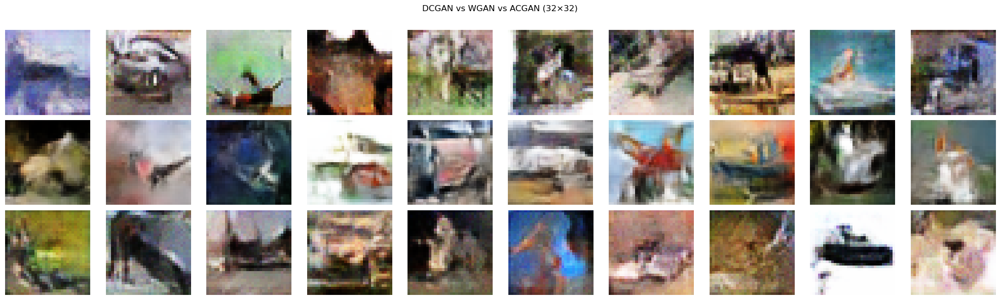

In [17]:
fig, axes = plt.subplots(3, 10, figsize=(20, 6))

with torch.no_grad():
    comparison_noise = torch.randn(10, noise_dimension).to(device)
    comparison_labels = torch.arange(0, 10).to(device)
    dcgan_comparison_samples = (generator_dcgan(comparison_noise, comparison_labels) * 0.5 + 0.5).cpu()
    for i in range(10):
        axes[0, i].imshow(dcgan_comparison_samples[i].permute(1, 2, 0).numpy())
        axes[0, i].axis('off')
        if i == 0:
            axes[0, i].set_ylabel('DCGAN')
    
    wgan_comparison_samples = (generator_wgan(comparison_noise, comparison_labels) * 0.5 + 0.5).cpu()
    for i in range(10):
        axes[1, i].imshow(wgan_comparison_samples[i].permute(1, 2, 0).numpy())
        axes[1, i].axis('off')
        if i == 0:
            axes[1, i].set_ylabel('WGAN')
    
    acgan_comparison_samples = (generator_acgan(comparison_noise, comparison_labels) * 0.5 + 0.5).cpu()
    for i in range(10):
        axes[2, i].imshow(acgan_comparison_samples[i].permute(1, 2, 0).numpy())
        axes[2, i].axis('off')
        axes[2, i].set_xlabel(class_names[i])
        if i == 0:
            axes[2, i].set_ylabel('ACGAN')

plt.suptitle(f'DCGAN vs WGAN vs ACGAN ({IMAGE_SIZE}×{IMAGE_SIZE})\n')

plt.tight_layout()
plt.show()